# Craft Beer Ratings

In [2]:
%autosave 0

Autosave disabled


In [3]:
%matplotlib inline
import string
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import psycopg2
import seaborn as sbn
from altair import Chart, X, Y, Color, Scale
import altair as alt
import requests
import nltk
from nltk.corpus import stopwords 
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from graphviz import Digraph

matplotlib.style.use('ggplot')


## Reading List

* Reshaping data
* Linear Regression
* Mulitple Regression
* Logistic Regression
* Sentiment Analysis and NLTK

## Exploratory Questions


1. Is the data complete?  What data is missing and how much?
1. what is the highest/lowest rated beer? (based on the average of all of its ratings)
1. What is the distribution of the overall beer ratings?
1. Are there styles of beers that tend to get higher ratings than others?
1. Does the ABV values for beer correlate with any of the reviews / rankings?
1. What is the breakdown of gender for the reviewers?
1. Do any of the styles of beers appeal more to one gender or the other?
1. Is the taste rating a good predictor for the overall rating?
1. If we simplify the problem to a thumbs-up versus thumbs-down rating can we predict better?

## Research Question (Kaggle contest)

1. Can we use the textual review of to predict an overall rating for the beer?

This is a great research question for us because there is a lot of freedom to process the text reviews in any way we want/can in order to make the best ratings possible.

In [5]:
bf = pd.read_csv('Data/beer_train.csv')

In [6]:
bf.head()

,index,beer/ABV,beer/beerId,beer/brewerId,beer/name,beer/style,review/appearance,review/aroma,review/overall,review/palate,review/taste,review/text,review/timeStruct,review/timeUnix,user/ageInSeconds,user/birthdayRaw,user/birthdayUnix,user/gender,user/profileName
0,40163,5.0,46634,14338,Chiostro,Herbed / Spiced Beer,4.0,4.0,4.0,4.0,4.0,Pours a clouded gold with a thin white head. N...,"{'min': 38, 'hour': 3, 'mday': 16, 'sec': 10, ...",1229398690,NaN,NaN,NaN,NaN,RblWthACoz
1,8135,11.0,3003,395,Bearded Pat's Barleywine,American Barleywine,4.0,3.5,3.5,3.5,3.0,12oz bottle into 8oz snifter.\t\tDeep ruby red...,"{'min': 38, 'hour': 23, 'mday': 8, 'sec': 58, ...",1218238738,NaN,NaN,NaN,NaN,BeerSox
2,10529,4.7,961,365,Naughty Nellie's Ale,American Pale Ale (APA),3.5,4.0,3.5,3.5,3.5,First enjoyed at the brewpub about 2 years ago...,"{'min': 7, 'hour': 18, 'mday': 26, 'sec': 2, '...",1101492422,NaN,NaN,NaN,Male,mschofield
3,44610,4.4,429,1,Pilsner Urquell,Czech Pilsener,3.0,3.0,2.5,3.0,3.0,First thing I noticed after pouring from green...,"{'min': 7, 'hour': 1, 'mday': 20, 'sec': 5, 'y...",1308532025,1.209827e+09,"Aug 10, 1976",208508400.0,Male,molegar76
4,37062,4.4,4904,1417,Black Sheep Ale (Special),English Pale Ale,4.0,3.0,3.0,3.5,2.5,A: pours an amber with a one finger head but o...,"{'min': 51, 'hour': 6, 'mday': 12, 'sec': 48, ...",1299912708,NaN,NaN,NaN,NaN,Brewbro000


### Checking for missing data

The easiest way to check for missing data in pandas is to use the `isna` method on the dataframe.  Used alone this gives you a giant table of True/False values depending on whether a particular cell in the dataframe has a value. We are interested in knowing if any of our columns have missing values and we can use the any function to reduce the big matrix into a table of columns.  

In [7]:
bf.isna().any(axis=0)

index                False
beer/ABV             False
beer/beerId          False
beer/brewerId        False
beer/name            False
beer/style           False
review/appearance    False
review/aroma         False
review/overall       False
review/palate        False
review/taste         False
review/text           True
review/timeStruct    False
review/timeUnix      False
user/ageInSeconds     True
user/birthdayRaw      True
user/birthdayUnix     True
user/gender           True
user/profileName      True
dtype: bool

In [8]:
print("total len = ", len(bf))
print("missing: ", len(bf[bf['user/gender'].isna() == True]))

total len =  37500
missing:  22186


## Distribution of ratings

To get a sense for the overall distribution of ratings of the beer.

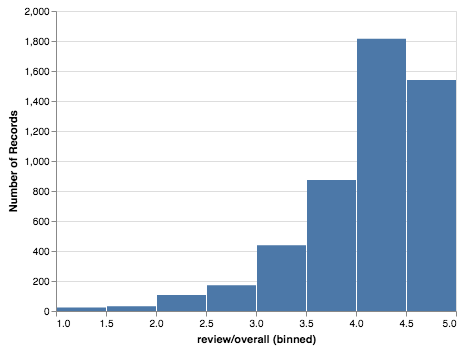

In [9]:
alt.Chart(bf[['review/overall']].sample(5000)).mark_bar().encode(alt.X('review/overall', bin=True), alt.Y('count()'))


## What are the Highest / Lowest rated beers according to their mean overall rating

For this question we want to group the beer by their id (some beers from different brewers **do** have the same name so we use the id to be sure that we are getting the ratings only for a particular beer.


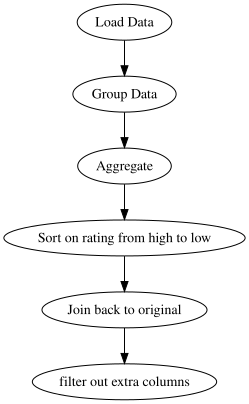

In [29]:

dot = Digraph(comment='The Round Table')

dot.node('A', 'Load Data')
dot.node('B', 'Group Data')
dot.node('L', 'Aggregate')
dot.node('S', 'Sort on rating from high to low')
dot.node('J', 'Join back to original')
dot.node('F', 'filter out extra columns')
dot.edges(['AB', 'BL', 'LS', 'SJ', 'JF'])

dot

In [31]:
byid = bf.groupby('beer/beerId')[['review/overall']].mean().sort_values(['review/overall'], ascending=False)
byid.merge(bf[['beer/beerId', 'beer/name', 'beer/style']], left_index=True, right_on='beer/beerId').head(10)


,review/overall,beer/beerId,beer/name,beer/style
10640,5.0,77207,Black IPA,American Black Ale
16450,5.0,75449,Centennial Pale Ale,American Pale Ale (APA)
8273,5.0,32283,Chocolate Nutter,English Stout
26147,5.0,72118,Bourbon Barrel Coffee Night Train,American Porter
4719,5.0,72007,Saisonnaire,Saison / Farmhouse Ale
17628,5.0,40448,BourbonDog ESB,Extra Special / Strong Bitter (ESB)
25797,5.0,63460,Limping Mallard,English Strong Ale
25082,5.0,55601,Suicide By Hops,American IPA
28518,5.0,44081,Gene's American Brown Ale,American Brown Ale
11379,5.0,64487,Bigwood Oak Aged Stout,American Double / Imperial Stout


That looks a bit complicated but its not really too bad if you break it down.

    Group = bf.groupby('beer/beerId')[['review/overall']]
    Aggregate = Group.mean()
    Sort = Aggregate.sort_values('review/overall', ascending=False)
    Join = byid.merge(bf[['beer/beerId', 'beer/name', 'beer/style']], left_index=True, right_on='beer/beerId').head(10)



### Practice Questions

1. What are the 10 worst beers?
1. Like any recommendation system its hard to judge just based on a single number.  Its important to know how many ratings that number was based on.  If its just one person rating something a 5 thats a lot less impressive than 5000 people rating it a 5.  Add a column to the above chart that shows the number of ratings.
1. This might also make you wonder about the other ratings.  What are the 10 best beers by taste?  Are they the same 10 as for the overall?
2. What are the 10 best beers according to women?
3. What are the 10 best beers according to men?

In [339]:
bf['beer/style'].unique()

array(['Herbed / Spiced Beer', 'American Barleywine',
       'American Pale Ale (APA)', 'Czech Pilsener', 'English Pale Ale',
       'Russian Imperial Stout', 'American Wild Ale', 'Pumpkin Ale',
       'English Barleywine', 'American IPA', 'Scotch Ale / Wee Heavy',
       'American Double / Imperial Stout', 'Euro Pale Lager',
       'Maibock / Helles Bock', 'American Amber / Red Ale', 'Rye Beer',
       'American Double / Imperial IPA', 'MÃ¤rzen / Oktoberfest',
       'Fruit / Vegetable Beer', 'Witbier', 'Light Lager', 'Rauchbier',
       'American Porter', 'Hefeweizen',
       'Extra Special / Strong Bitter (ESB)', 'Wheatwine',
       'English Strong Ale', 'Braggot', 'Euro Strong Lager',
       'Munich Helles Lager', 'English India Pale Ale (IPA)', 'Altbier',
       'Doppelbock', 'American Brown Ale', 'Munich Dunkel Lager',
       'Irish Dry Stout', 'KÃ¶lsch', 'Foreign / Export Stout',
       'Cream Ale', 'Lambic - Unblended', 'Scottish Ale', 'Baltic Porter',
       'Belgian IPA', 'Ol

In [340]:
bf.groupby('beer/style', as_index=False)['review/overall'].agg({'review/overall':'mean', 'review/aroma':'count'}).sort_values('review/overall', ascending=False)

,beer/style,review/overall,review/aroma
11,American Double / Imperial Stout,4.326919,4495
41,English Barleywine,4.233333,90
64,Keller Bier / Zwickel Bier,4.184211,19
81,Russian Imperial Stout,4.168061,2032
82,Rye Beer,4.162362,1355
74,Munich Helles Lager,4.096115,489
44,English Dark Mild Ale,4.062500,16
21,Baltic Porter,4.047030,404
12,American IPA,4.045082,3050
20,American Wild Ale,4.040000,75


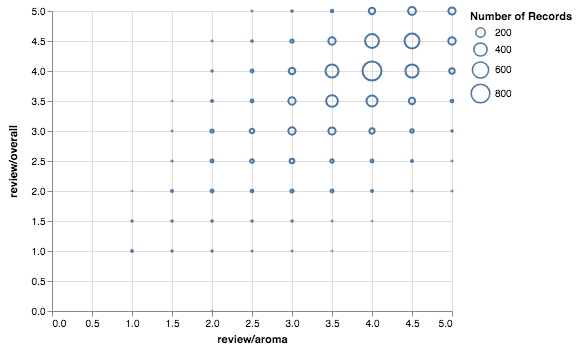

In [341]:
alt.Chart(bf.sample(5000)).mark_point().encode(y='review/overall',x='review/aroma', size='count()')

In [342]:
cm = bf[['review/appearance','review/overall','review/palate', 'review/taste', 'beer/ABV']].corr()
cm

,review/appearance,review/overall,review/palate,review/taste,beer/ABV
review/appearance,1.000000,0.498733,0.555833,0.531676,0.288376
review/overall,0.498733,1.000000,0.697220,0.785220,0.197005
review/palate,0.555833,0.697220,1.000000,0.732092,0.350656
review/taste,0.531676,0.785220,0.732092,1.000000,0.354033
beer/ABV,0.288376,0.197005,0.350656,0.354033,1.000000


In [343]:
cm.reset_index(inplace=True)
cm = cm.melt(id_vars='index', value_vars=['review/appearance','review/overall','review/palate', 'review/taste', 'beer/ABV'], value_name='corr', var_name='attribute')


In [344]:
cm.head()

,index,attribute,corr
0,review/appearance,review/appearance,1.000000
1,review/overall,review/appearance,0.498733
2,review/palate,review/appearance,0.555833
3,review/taste,review/appearance,0.531676
4,beer/ABV,review/appearance,0.288376


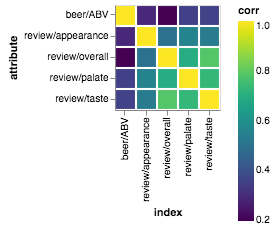

In [345]:
alt.Chart(cm).mark_rect().encode(x='index',y='attribute',color='corr')


In [346]:
bf.groupby('beer/beerId').agg({'review/overall':'mean', 'review/taste':'count'})


,review/overall,review/taste
beer/beerId,,
175,3.544643,56
176,3.858696,92
178,3.477941,68
429,3.834741,947
436,2.752174,345
454,4.142857,21
503,4.000000,1
505,4.211538,26
507,4.275862,29


Try a regression using just taste

1. Split the data into training and test
2. train the model
    1. training tries to find the coefficient that minimizes the MSE
    2. Lets look at that in Google Sheets with Solver
    3. Lets take our first look at scikit-learn

3. make predictions on the test
4. calculate the error.
    1. MAE
    1. MSE
    
5. Improving the model
    1. Use more variables such as appearance, pallete and ABV
    2. Normalize!

6. The real challenge is to use the text of the review.
    1. turning text into numeric data
    2. what to look for?
    3. What is one-hot encoding?
    
    

## Linear Regression with Scikit-Learn

Scikit-learn has an easy to use API that will allow us to train a model use that model to make predictions, and then look at results!  You don't have to understand any of the math behind the models that we will build, but it is really helpful for you to develop some intuition for when a certain kind of model is useful versus using a different model.

To show you how easy this is lets build a simple one variable Linear regression model that we know from our exploratory analysis of the data will work pretty well.  That is if we know the rating that a user made about the taste of the beer there was a .79 correlation with how they rated beer overall.  

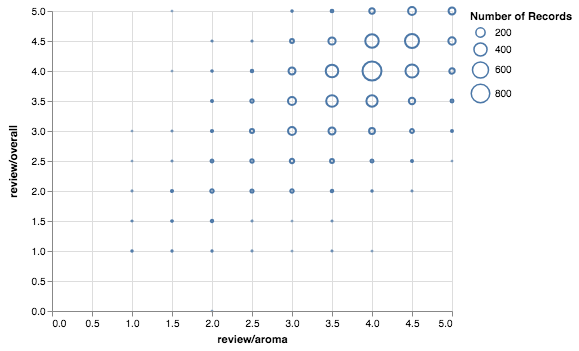

In [347]:
alt.Chart(bf.sample(5000)).mark_point().encode(y='review/overall',x='review/aroma', size='count()')

To test our hypothesis that the taste rating is a good predictor for the overall rating, we will build a linear regression model.  Just like we did in AC101 with the Pizza data where we used the diameter of the pizza as a predictor for the cost of the pizza.

To be a little more scientific about this we will split our data into a "training set" that we will use to build the model, and a "test set" that we will use to validate the model.  That is we want to test our model on data that is different from the data we used to build the model.  Testing using the data the you trained on would be like cheating as you could just build a model the memorized everything and got 100% but in the real world you need to make predictions for things that you have not seen before.  

The first thing we'll do create two simplified dataframes one that contains a column containing the taste rating for each beer and a second column that contains the overall rating.  Next we'll randomly select 80% of the data to use in creating our linear regression model, and 20% of the data to use in testing.  scikit learn gives us a handy function that does all of that for us.  We'll end up with four data frames:

* train_X, train_y - this is the data we'll use to create our model.  Remember that in linear regression we are trying to come up with a slope and intercept value that minimize the error, so we need to know the answer.

* test_X - we will use this data (without train_y) to make predictions given a rating from test_X we'll use our model to caculate a predicted overall value.

* test_y - we will use this data along with the predicted values to come up with our score.  The score we calculate will be the mean absolute error.



In [348]:
beer_X = bf[['review/taste']]
beer_y = bf[['review/overall']]
train_X, test_X, train_y, test_y = train_test_split(beer_X, beer_y, random_state=42)

In [349]:
rmodel = LinearRegression()
rmodel.fit(train_X.values, train_y.values)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None,
         normalize=False)

In [350]:
preds = rmodel.predict(test_X)

In [351]:
abs(preds-test_y).mean()

review/overall    0.325997
dtype: float64

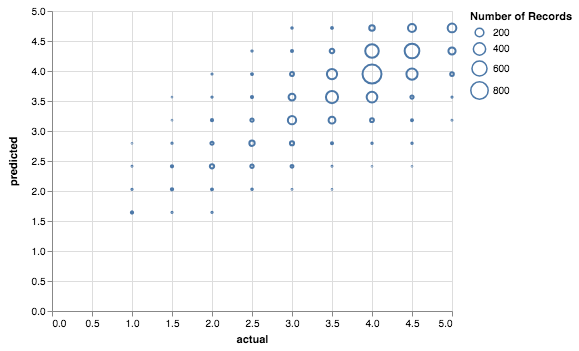

In [352]:
alt.Chart(pd.DataFrame({'actual': test_y['review/overall'].values[:5000], 'predicted':preds.ravel()[:5000]})).mark_point().encode(x='actual',y='predicted',size='count()')

Let us compare the distribution of the predictions


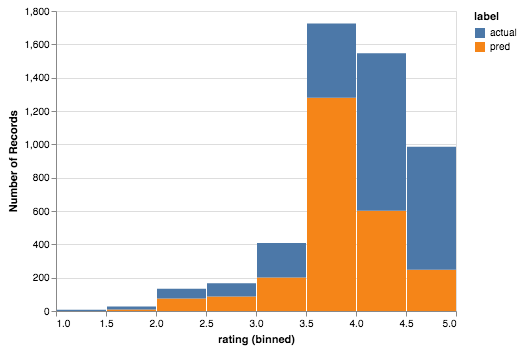

In [353]:
alt.Chart(pd.DataFrame({'rating': np.concatenate((preds.ravel()[:2500], test_y['review/overall'].values[:2500])), 
                        'label':['pred']*2500 + ['actual']*2500 })).mark_bar().encode(
    x=alt.X('rating', bin=True), y='count()', color='label')

So you can see that the predictions tend to underpredict the actual rating by a bit.  The predictor makes a lot more predictions in the 3.5 to 4.0 range than there are actual ratings and the predictor predicts far fewer rathings in the 4.5 to 5 range than actual.

In [354]:
train_y['review/overall'].mean()

3.888871111111111

In [355]:
len(preds)

9375

In [356]:
avg_preds = np.full(9373, train_y['review/overall'].mean())

In [357]:
abs(avg_preds-test_y.values).mean()

0.522489222637008

So, the good news is that our linear regression does better than just predicting the average.  Can we do better with more data?  What if we include the review/pallete and review/appearance as part of the training data?


In [358]:
beer_X = bf[['review/taste', 'review/palate', 'review/appearance']]
beer_y = bf[['review/overall']]
train_X, test_X, train_y, test_y = train_test_split(beer_X, beer_y, random_state=42)

In [359]:
rmodel = LinearRegression()
rmodel.fit(train_X.values, train_y.values)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None,
         normalize=False)

In [360]:
preds = rmodel.predict(test_X)

In [361]:
abs(preds-test_y.values).mean()

0.30952150457163924

Thats a little better .30 is a bit smaller error than .32.

We do have more data that we could try to exploit.

1. We know the ABV (Alchohol By Volume) for each beer.  We could use that easily as it is another numeric field.
2. We have some information about the reviewers, but as we saw from our earlier analysis we are missing 70 percent of it.  
3. We have the text of the review, which if we were reading them ourselves would give us a very good indication of whether the review was going to be positive or negative.

Strategies 1 and 3 are the most interesting and each will introduce some important machine learning concepts so lets take a look.

1. If we add the ABV value we can see that it is on a different scale than our various user entered ratings.  So its a good idea to rescale the data. so it is on a scale from -1 to 1  where the mean of the data is moved to 0 (StandardScaler) or just 0 to 1 (MinMaxScaler).

As a baseline lets add in the ABV value without doing any rescaling to see what our error looks like.  Then we will rescale and try again to see if we really get any improvement.

## Rescaling and using ABV

In [362]:
beer_X = bf[['review/taste', 'review/palate', 'review/appearance', 'beer/ABV']]
beer_y = bf[['review/overall']]
train_X, test_X, train_y, test_y = train_test_split(beer_X, beer_y, random_state=42)

In [363]:
rmodel = LinearRegression()
rmodel.fit(train_X.values, train_y.values)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None,
         normalize=False)

In [364]:
preds = rmodel.predict(test_X)

In [365]:
abs(preds-test_y.values).mean()

0.30576431129937715

Adding in the ABV gives us a slight edge.  Lets see if rescaling helps even more.

In [366]:
scaler = StandardScaler()
scaled_X = scaler.fit_transform(beer_X)

In [367]:
train_X, test_X, train_y, test_y = train_test_split(scaled_X, beer_y, random_state=42)

In [368]:
rmodel = LinearRegression()
rmodel.fit(train_X, train_y.values)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None,
         normalize=False)

In [369]:
preds = rmodel.predict(test_X)

In [370]:
abs(preds-test_y.values).mean()

0.3057643112993791

In [371]:
np.sqrt(((preds-test_y) ** 2.0).mean())

review/overall    0.403833
dtype: float64

OK, so that didn't help at all (It didn't hurt either) in this case.  The statistics below show that 75% of the values for ABV are betwen 0 and 9.4 which is not too far off from our 0 to 5 rating scale.

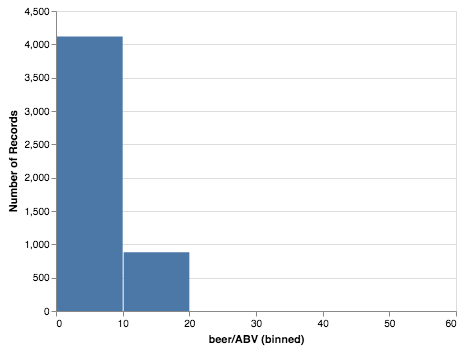

In [372]:
alt.Chart(bf.sample(5000)).mark_bar().encode(alt.X('beer/ABV', bin=True), y='count()')

In [373]:
bf['beer/ABV'].describe()

count    37500.000000
mean         7.403725
std          2.318145
min          0.100000
25%          5.400000
50%          6.900000
75%          9.400000
max         57.700000
Name: beer/ABV, dtype: float64

## Exercise -- Simplify the problem

One way that we could potentially make this easier on ourselves would be to reduce the ratings to a thumbs up or thumbs down, 0 or 1 rating.  We could introduce a threshold value and convert all of the rating/overall values to either 0 or 1 then we have only two values to try to predict.  What we are really doing now is trying to classify the beer as a 'good beer' or a 'bad beer'.  This will change our measure of success too.

You will need to do the following steps:

1. transform the rating/overall values to 0 or 1 (you decide the threshold and give some justification)
2. remake the training and test data
3. retrain and test the model

How did you do?  Now remember if you are off by .3 now that is much much worse than before as you are trying to predict between 0 and 1 rather than 0 and 5

Make a graph of the distribution of your predictions.

What if we could change that distribution to look more like the red bars in this graph.

<img src='compare_bars.png'>

One way to get there would be to modify all of your predicted values to be either 0 or 1 based on a threshold.  With some trial and error at picking the threshold you might get really good results.  In fact there is a graph called an ROC curve that will help you pick that threshold.  But We will leave that as an advanced research project.

For now we will use a slightly different kind of regression algorithm called logistic regression.  Its called this because it applys a logistic function to the predicted values during the training cycle.  The function has the property that it forces all of the values toward 0 and 1 anything less than 0 becomes 0 and anything more than 1 becomes 1.  But... because this happens during the training cycle the all of our values are going to end up very close to 0 or 1 just like the red bars in the graph above.  But we don't have to figure out the best threshold.

Let us see how easy it is to train a LogisticRegression model using scikit learn!

In [374]:
# start by converting everything to a thumbs up / thumbs down rating.
bf['thumbs'] = bf['review/overall'].map(lambda x : 1 if x >= 3.5 else 0)

In [375]:
beer_X = bf[['review/taste', 'review/palate', 'review/appearance', 'beer/ABV']]
beer_y = bf[['thumbs']]
train_X, test_X, train_y, test_y = train_test_split(beer_X, beer_y, random_state=42)

Now instead of LinearRegression we use 

In [376]:
rmodel = LogisticRegression(solver='lbfgs')
rmodel.fit(train_X.values, train_y.values.ravel())

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='warn',
          n_jobs=None, penalty='l2', random_state=None, solver='lbfgs',
          tol=0.0001, verbose=0, warm_start=False)

In [377]:
preds = rmodel.predict(test_X)

In [378]:
abs(preds-test_y.values).mean()

0.23650757973333333

OH NO!! Our error value looks horrible!  Whats going on?  Don't panic.  Lets look at the distribution of our predictions and see if that gives us some insight.

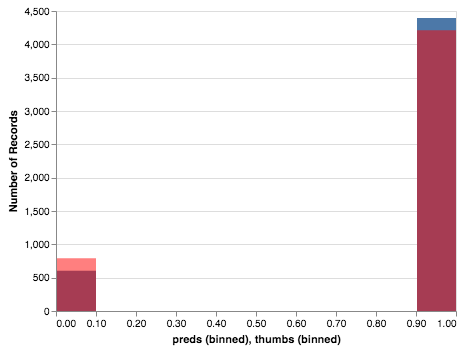

In [379]:
alt.Chart(pd.DataFrame({'preds':preds.ravel()[:5000]})).mark_bar().encode(alt.X('preds',bin=True), y='count()') + \
alt.Chart(bf.sample(5000)).mark_bar(color='red',opacity=0.5).encode(alt.X('thumbs',bin=True),y='count()')

It looks like we are slightly overpredicting thumbs down but slightly underpredicting thumbs up.  But the distance of the errors is now much worse we are off by 1 when we are wrong.  But how many values are we off by nearly 1 on?

When we are doing a classification problem we can use the accuracy score function of scikit learn to tell us the fraction of the time we are correct.  In this case it is not too bad at 92% thats a solid A- anyway.

In [380]:
accuracy_score(test_y, preds)

0.9218133333333334

# A harder problem -- Use the text and any other data you can find to predict review/overall or review/taste

Now for the curveball. You are **not allowed to use any of the review data** in your model.  Only the ABV and whatever you can make out of the review/text field.

1. Go back to trying to make a prediction between 0 and 5
2. build a LinearRegression model using only ABV how well does that work?
3. Next we need to convert what we can find in the review/text column into some numerical values.  There are a couple of avenues you might try:
    1. Convert the whole text to a score based on how positive or negative it seems (sounds like sentiment analysis)
    2. Add columns for a "bunch" of key words that appear in reviews for examply hoppy or bitter if the review contains the word then that column gets a 1 for that review if it does not then it gets a 0.  You might end up adding 25 or 30 columns like this.  Some of the columns might represent words like 'horrible' or 'terrific' or 'dark' or 'creamy'.  

The challenge is to see how low you can make your MAE using only this data.  You could also try this using the thumbs up and thumbs down approach and see if you can beat our .92 score.

This is the problem posed on a real life Kaggle competition.  If you can get better than a .57 Root Mean Squared Error then you would have made the top 7 and been on the leaderboard.  If you can do better than .63 then your instructor better give you an A for this exercise because that is better than I did.

## Exploratory analysis of the review text

In [381]:
bf['review/text'] = bf['review/text'].str.lower()

In [382]:
bf.loc[:5,'review/text']

0    pours a clouded gold with a thin white head. nose is quite floral with a larger amount of spices...
1    12oz bottle into 8oz snifter.\t\tdeep ruby red hue with a one finger light tan head that settles...
2    first enjoyed at the brewpub about 2 years ago, i finally managed to get a bottle.\tslightly haz...
3    first thing i noticed after pouring from green bottle to glass was the skunky smell. overpowerin...
4    a: pours an amber with a one finger head but only with a very strong pour, head recedes to a lig...
5    served in a snifter; on-tap at cbc.\t\tcolor is the typical imperial stout used motor oil black;...
Name: review/text, dtype: object

In [383]:
import string
bf['review/text'] = bf['review/text'].str.translate(str.maketrans(string.punctuation, ' '*len(string.punctuation)))


In [384]:
bf['text_list'] = bf['review/text'].str.split()

In [385]:
from  collections import Counter

In [386]:
bf.dropna(inplace=True, subset=['text_list'])

In [387]:
sw = set(stopwords.words('english'))
[sw.add(x) for x in ['beer','taste','head']]


[None, None, None]

What are common words that are used to describe bad beers but not good beers?  What are words that are used to describe good beers but not bad beers?

In [388]:
c = Counter()
_ = bf[bf['review/overall'] < 3.5].text_list.map(lambda x  : c.update([y for y in x if y not in sw]))
bad_beer_words = set([w[0] for w in c.most_common(200)])

In [389]:
c = Counter()
_ = bf[bf['review/overall'] >= 3.5].text_list.map(lambda x  : c.update([y for y in x if y not in sw]))
good_beer_words = set([w[0] for w in c.most_common(200)])

In [390]:
bad_beer_words - good_beer_words

{'3',
 'actually',
 'average',
 'brewery',
 'bubbles',
 'carbonated',
 'cherry',
 'else',
 'expected',
 'faint',
 'go',
 'going',
 'gold',
 'got',
 'grain',
 'grainy',
 'hard',
 'honey',
 'interesting',
 'kind',
 'lager',
 'looking',
 'looks',
 'metallic',
 'ok',
 'probably',
 'rather',
 'say',
 'seems',
 'somewhat',
 'sour',
 'watery',
 'weak',
 'wheat',
 'yeast',
 'yellow'}

In [423]:
#my_bb_words = ['horrible', 'terrible', 'bad', 'nasty', 'gross', 'average', 'carbonated', 'interesting', 'cherry', 'faint', 'grain', 'metallic', 'watery', 'sour', 'weak', 'wheat', 'yeast', 'yellow']
manual_bb_words = set(['horrible', 'terrible', 'nasty', 'gross', 'bad'])
my_bb_words = list(bad_beer_words - good_beer_words | manual_bb_words)

In [392]:
good_beer_words - bad_beer_words

{'4',
 'balanced',
 'burnt',
 'colored',
 'come',
 'complex',
 'earthy',
 'easy',
 'excellent',
 'finishes',
 'founders',
 'fresh',
 'grapefruit',
 'huge',
 'love',
 'makes',
 'nicely',
 'oak',
 'perfect',
 'pine',
 'porter',
 'presence',
 'present',
 'rich',
 'rye',
 'side',
 'sip',
 'smoked',
 'solid',
 'spicy',
 'sticky',
 'sugar',
 'tasty',
 'thanks',
 'toffee',
 'tongue'}

In [425]:
#my_gb_words = ['great', 'awesome', 'good', 'toffee', 'amazing', 'spicy', 'smoked', 'rye', 'perfect', 'oak', 'fresh', 'excellent', 'complex', 'earthy', 'balanced', 'easy']
manual_gb_words = set(['great', 'awesome', 'perfect', 'amazing', 'wonderful'])
my_gb_words = list(good_beer_words - bad_beer_words | manual_gb_words)

In [426]:
for word in my_bb_words:
    bf[word] = bf.text_list.map(lambda x : 1 if word in x else 0)
    

In [427]:
for word in my_gb_words:
    bf[word] = bf.text_list.map(lambda x : 1 if word in x else 0)


In [428]:
bf.columns

Index(['index', 'beer/ABV', 'beer/beerId', 'beer/brewerId', 'beer/name',
       'beer/style', 'review/appearance', 'review/aroma', 'review/overall',
       'review/palate',
       ...
       'smoked', 'nasty', 'gross', 'bad', 'terrible', 'horrible', 'awesome',
       'amazing', 'wonderful', 'great'],
      dtype='object', length=102)

In [429]:
beer_X = bf[my_bb_words + my_gb_words + ['beer/ABV']]
beer_y = bf[['thumbs']]
train_X, test_X, train_y, test_y = train_test_split(beer_X, beer_y, random_state=42)

In [430]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import LinearSVC
#rmodel = LogisticRegression(solver='lbfgs')
rmodel = LinearRegression()
rmodel.fit(train_X.values, train_y.values.ravel())

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None,
         normalize=False)

In [431]:
preds = rmodel.predict(test_X)

In [432]:
abs(preds-test_y.values).mean()

0.27171860056966407

In [433]:
#accuracy_score(test_y, preds)

In [434]:
#np.sqrt(((preds-test_y) ** 2.0).mean())

In [435]:
sorted_weights = sorted(list(zip(beer_X.columns.tolist(), rmodel.coef_.ravel().tolist())), key=lambda x : x[1], reverse=True)
sorted_weights

[('easy', 0.09897475529700242),
 ('solid', 0.08193606042382606),
 ('tasty', 0.07926292696423745),
 ('perfect', 0.07429735785293201),
 ('excellent', 0.06874988526786646),
 ('awesome', 0.06233364191142189),
 ('balanced', 0.06045033839990843),
 ('wonderful', 0.05799172999897152),
 ('great', 0.05636937453118318),
 ('amazing', 0.05219272230869499),
 ('nicely', 0.04952653333618656),
 ('rich', 0.04942543734985559),
 ('rye', 0.04756608986925993),
 ('grapefruit', 0.047352162098180085),
 ('porter', 0.0412026680923209),
 ('complex', 0.04118874233301322),
 ('earthy', 0.03727280299704358),
 ('fresh', 0.03382554365023634),
 ('smoked', 0.032029959306983415),
 ('love', 0.030006154158548782),
 ('finishes', 0.026359252408330078),
 ('spicy', 0.024980833928766023),
 ('side', 0.021876927774935412),
 ('4', 0.02125435494723614),
 ('toffee', 0.02027943735216922),
 ('oak', 0.018260588038089724),
 ('tongue', 0.017796144294097545),
 ('pine', 0.014721932044263076),
 ('colored', 0.01353474137965632),
 ('thanks', 0

Lets see if we can visualize this 

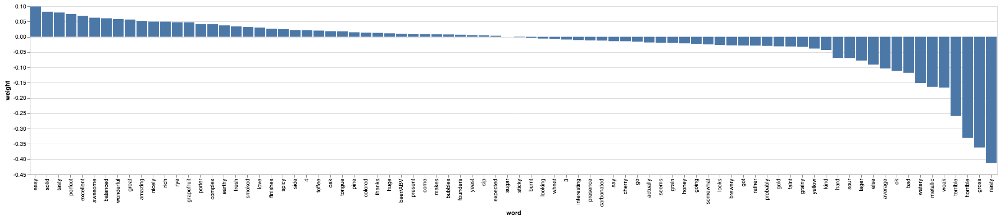

In [436]:

alt.Chart(pd.DataFrame([{'word': x[0], 'weight': x[1]} for x in sorted_weights])).mark_bar().encode(alt.X('word:N', sort=alt.EncodingSortField(field='weight:Q', op='values', order='ascending')),
                                                                                                    y='weight:Q')



If you look at it, its pretty interesting to see the two ends of the graph.  Look at the words that have the highest positive weights.  Who knew that 'grapefruit' was such a desireable characteristic of a beer!?

The question you may be asking yourself is "How does this work exactly?"   Lets take an example and work through it step by step using the weights above.

Here's an example of a review with a solid 5 rating.

In [419]:
pd.set_option('display.max_colwidth', 100)
bf.loc[12]

index                                                                                                              32481
beer/ABV                                                                                                            11.2
beer/beerId                                                                                                        19960
beer/brewerId                                                                                                       1199
beer/name                                                                        Founders KBS (Kentucky Breakfast Stout)
beer/style                                                                              American Double / Imperial Stout
review/appearance                                                                                                    4.5
review/aroma                                                                                                         4.5
review/overall                  

Now lets do the math.


In [437]:
set(bf.loc[12, 'text_list']) & (set(my_gb_words)  - set(my_bb_words))

{'founders', 'great'}

In [439]:
weight_d = dict(sorted_weights)
score = 0
for w in bf.loc[12, 'text_list']:
    weight = weight_d.get(w,0)
    if weight > 0:
        print(w, weight)
        score += weight * bf.loc[12, w]
    
print(score)

founders 0.006847636797134196
great 0.05636937453118318
0.06321701132831738


Even with a great beer we are not always going to hit the words.

## Sentiment Analysis with Python's Natural Language Toolkit (NLTK)

So, our simple approach to using words from the review is not too bad.